# Markus Notebook

Algorithms to try out in NetworkX:
- Girvan-Newman 
- Label propagation
- Modularity maximization 

Measuring partitions: 
- Modulairty 
- Maybe the others as well

### Imports

In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import random

### reading file

has been divided into monthly chunks

In [10]:
df = pd.read_csv('../../../Data/final_cool_dataset.csv')

# just taking alaska, to narrow it down
#df_m1_AK = df_m1[(df_m1.ORIGIN_STATE_NM =='Alaska') & (df_m1.DEST_STATE_NM == 'Alaska')]

In [11]:
#weird = {'JQF', 'YIP', 'DOV', 'ANB', 'AFW', 'MTO', 'GON'}
#df_weird = df[df['ORIGIN'].isin(weird) & df['DEST'].isin(weird)]

### creating graph

In [2]:

class Simulation:
    
    def __init__(self, edgelist):
        self.Graph = nx.DiGraph()
        self.Graph.add_edges_from(edgelist)
        for node in self.Graph.nodes():
            self.Graph.nodes[node]['sum_weight_root'] = np.sqrt(sum([self.Graph[node][i]['weight'] for i in self.Graph.neighbors(node)]) + 0.001)

    def foo(x, l):
        return e
    
    def one_tick(self, beta, infected):
        '''
        simulates one tick, taking a beta value and a set of already infected nodes
        returns a new set of infected nodes
        '''
        
        add_to_set = set()
        
        #print(infected)
        for node in infected:

            for neighbor in self.Graph.neighbors(node):
                if neighbor not in infected:
                    if beta * ((self.Graph[node][neighbor]['weight'] + 1) / self.Graph.nodes[node]['sum_weight_root']) > random.random():
                        add_to_set.add(neighbor)
                    
        return infected | add_to_set
   
    
    def simulate_amount_of_ticks(self, beta, outset='random', ticks=1):
        '''
        simulates specified amount of ticks, taking a beta value, an amount of ticks 
        and an initial outset of infected nodes (defaults a random node)
        returns a list of sets, each element being the set of infected nodes for each tick
        '''
        
        if outset == 'random':
            infected_list = [{random.choice(list(self.Graph.nodes()))}]
        else:
            infected_list = [outset]
        
        #print(infected_list)
        
        for _ in range(ticks):
            infected_list.append(self.one_tick(beta, infected_list[-1]))
    
        return infected_list
    
    def simulate_until_threshold(self, beta, threshold, outset='random', limit=500):
        '''
        simulates until a certain number of nodes are infected, taking a beta value,
        a threshold and a limit for amount of ticks
        returns the amount of ticks to get to threshold
        '''
        
        if outset == 'random':
            infected = {random.choice(list(self.Graph.nodes()))}
        else:
            infected = outset
        
        for i in range(limit):
            infected = self.one_tick(beta, infected)
            
            if len(infected) >= threshold:
                return i
    
        return limit
    
    def threshold_trials(self, beta, threshold, outset='random', limit=500, trials=10):
        '''
        simulates a number of trials using the threshold method,
        returning a list of the amount of ticks to reach threshold
        '''
        
        return [self.simulate_until_threshold(beta=beta, threshold=threshold, outset=outset, limit=limit) for _ in range(trials)]   

In [6]:
#edges = [(row['ORIGIN_AIRPORT_ID'], row['DEST_AIRPORT_ID'], {column:row[column] for column in df_m1_AK.columns}) for _, row in df_m1_AK.iterrows()]

edges = [(row['ORIGIN'], row['DEST'], {'weight': row['PASSENGERS']}) for _, row in df.iterrows()]

In [7]:
sim1 = Simulation(edges)
sim2 = Simulation(edges)

In [8]:
sim1_trials = sim1.threshold_trials(beta=0.005, threshold=300, trials=10)
sim2_trials = sim2.threshold_trials(beta=0.005, threshold=300, trials=10)

KeyboardInterrupt: 

#### Bootstrapping

In [ ]:
def two_sample_bootstrap(x, y, samples=100):
    s_d = np.sqrt((np.var(x) / len(x)) + (np.var(y) / len(y)))
    t_d = (np.mean(x) + np.mean(y)) / s_d
    
    bootstraps = []
    for _ in range(samples):
        x_s = np.random.choice(x, size=len(x), replace=True)
        y_s = np.random.choice(y, size=len(y), replace=True)
        s_d_s = np.sqrt((np.var(x_s) / len(x_s)) + (np.var(y_s) / len(y_s)))
        t_d_s = (np.mean(x_s) + np.mean(y_s)) / s_d_s
        bootstraps.append(t_d_s)
    
    return t_d, bootstraps

In [ ]:
t_d, bootstraps = two_sample_bootstrap(sim1_trials, sim2_trials, samples=10000)

In [ ]:
t_d, np.quantile(bootstraps, (0.05, 0.95))

## viz

In [3]:
df = pd.read_csv('../../../Data/final_cool_dataset.csv')

In [4]:
coords = pd.read_json('../../../Data/total.json')

In [5]:
coords = coords.T.reset_index()

coords_origin = coords.rename(columns = {'index':'ORIGIN',0:'longitude_origin',1:'latitude_origin'})
coords_dest = coords.rename(columns = {'index':'DEST',0:'longitude_dest',1:'latitude_dest'})

data_filtered_coord = pd.merge(df,coords_origin, on = ['ORIGIN'])

data_filtered_coord = pd.merge(data_filtered_coord,coords_dest, on = ["DEST"])

mask1 = ~data_filtered_coord['ORIGIN'].isin(['SYA','TNK','RBN']) & ~data_filtered_coord['DEST'].isin(['SYA','TNK','RBN'])

coords_name_df = pd.DataFrame()
coords_name_df['ORIGIN'] = data_filtered_coord[mask1]['ORIGIN']
coords_name_df['COORDS'] = list(zip(data_filtered_coord[mask1]['latitude_origin'],data_filtered_coord[mask1]['longitude_origin']))

In [6]:
G = nx.DiGraph()

In [7]:

pos = dict()
for i,j in zip(coords_name_df['ORIGIN'],coords_name_df['COORDS']):
    pos[i] = (j[0],j[1])
    G.add_node(i)

In [8]:
data_filtered_coord

,ORIGIN,DEST,PAYLOAD,DISTANCE,SEATS,PASSENGERS,DEPARTURES_PERFORMED,CARRIER_NAME,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,ORIGIN_NAME,DEST_NAME,longitude_origin,latitude_origin,longitude_dest,latitude_dest
0,ABL,OME,10500.0,280.0,4.0,0.0,2.0,['Bering Air Inc.'],10139,13873,"Ambler, AK: Ambler River","Nome, AK: Nome Airport",67.100000,-157.816667,64.512199,-165.445007
1,AIN,OME,4500.0,448.0,19.0,0.0,1.0,['Hageland Aviation Service'],10225,13873,"Wainwright, AK: Wainwright Airport","Nome, AK: Nome Airport",70.633333,-160.033333,64.512199,-165.445007
2,ANC,OME,33729908.0,539.0,31762.0,20623.0,1133.0,['Era Aviation' 'Alaska Airlines Inc.'\r\n 'Ta...,10299,13873,"Anchorage, AK: Ted Stevens Anchorage Internati...","Nome, AK: Nome Airport",61.174400,-149.996002,64.512199,-165.445007
3,ATK,OME,4500.0,463.0,19.0,0.0,1.0,['Hageland Aviation Service'],10396,13873,"Atqasuk, AK: Atqasuk Edward Burnell Sr. Memorial","Nome, AK: Nome Airport",70.467040,-157.436013,64.512199,-165.445007
4,AUK,OME,39300.0,129.0,26.0,7.0,9.0,['Arctic Transportation' 'Bering Air Inc.' 'Ha...,10416,13873,"Alakanuk, AK: Alakanuk Airport","Nome, AK: Nome Airport",62.680042,-164.659927,64.512199,-165.445007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21144,KEH,ODW,1481.0,39.0,16.0,4.0,1.0,['Kenmore Air Harbor'],12652,13821,"Kenmore, WA: Kenmore Air Harbor","Oak Harbor, WA: A.J. Eisenberg",47.738333,-122.268056,48.283333,-122.616667
21145,LKE,TWD,12962.0,37.0,76.0,27.0,4.0,['Kenmore Air Harbor'],13002,15387,"Seattle, WA: Lake Union Terminal","Port Townsend, WA: Jefferson County International",47.628889,-122.338611,48.116667,-122.766667
21146,KEH,TWD,1030.0,33.0,4.0,2.0,1.0,['Kenmore Air Harbor'],12652,15387,"Kenmore, WA: Kenmore Air Harbor","Port Townsend, WA: Jefferson County International",47.738333,-122.268056,48.116667,-122.766667
21147,HAO,UOX,2000.0,442.0,8.0,2.0,1.0,['Avjet Corporation'],12068,15481,"Hamilton, OH: Butler County Regional Hogan Field","Oxford, MS: University-Oxford",39.363800,-84.522003,34.384300,-89.536797


In [9]:
for i,j,k in zip(data_filtered_coord[mask1]['ORIGIN'],data_filtered_coord[mask1]['DEST'],data_filtered_coord[mask1]['PASSENGERS']):
    G.add_edge(i,j,weight=k)

In [10]:
for node in G.nodes():
            G.nodes[node]['sum_weight_root'] = np.sqrt(sum([G[node][i]['weight'] for i in G.neighbors(node)]) + 0.001)

In [11]:
edges = [(row['ORIGIN'], row['DEST'], {'weight': row['PASSENGERS']}) for _, row in df.iterrows()]

In [12]:
sim1 = Simulation(edges)

In [13]:
sim1.Graph = G

In [14]:
sets = sim1.simulate_amount_of_ticks(beta=0.05, ticks=20)

In [15]:
G.nodes

NodeView(('ABL', 'AIN', 'ANC', 'ATK', 'AUK', 'BET', 'BKC', 'BRW', 'CIL', 'DIO', 'DRG', 'ELI', 'EMK', 'FAI', 'FBK', 'GAL', 'GAM', 'GLV', 'GMT', 'HPB', 'HSL', 'IAN', 'KAL', 'KKA', 'KOT', 'KPC', 'KSM', 'KTS', 'KVL', 'MCG', 'MLL', 'MOS', 'MOU', 'MRI', 'OBU', 'OHC', 'ORV', 'OTZ', 'PHO', 'PQS', 'RBY', 'SCM', 'SHH', 'SKK', 'SMK', 'SVA', 'SXP', 'TLA', 'TNC', 'UNK', 'VAK', 'VEE', 'WAA', 'WBB', 'WLK', 'WMO', 'WTK', '04A', 'AKP', 'CDL', 'HCR', 'KYU', 'LUR', 'NUI', 'NUL', 'OME', 'PIZ', 'RDB', 'RLU', 'SCC', 'SHG', 'AET', 'ARC', 'BTT', 'FYU', 'TAL', 'WBQ', 'WCR', 'A26', 'A27', 'A63', 'ADQ', 'AK5', 'AK7', 'ANI', 'ANV', 'BTI', 'BUR', 'CDV', 'CEM', 'CIK', 'CKU', 'CKX', 'CXF', 'CZN', 'DCK', 'DEN', 'EAA', 'ENN', 'FWL', 'GBH', 'GEK', 'HGZ', 'HKB', 'HUS', 'IGG', 'ILI', 'IND', 'IRC', 'JNU', 'KBC', 'KGX', 'LIV', 'LMA', 'LNI', 'MEM', 'MHM', 'MLY', 'MNT', 'MSP', 'NIB', 'ORD', 'ORT', 'PDX', 'PPC', 'RMP', 'SEA', 'SVS', 'TCT', 'TKJ', 'TLJ', 'UMT', 'UTO', 'VIK', 'YAK', 'DLG', 'TLT', 'PAQ', 'ENA', 'DQH', 'UUK', 'AK

In [16]:
from copy import deepcopy

In [17]:
def remove_edges(graph, nodes_to_remove):
    for node in nodes_to_remove:
        to_remove = deepcopy(graph.edges([node]))
        for elm in to_remove:
            graph.remove_edge(elm[0],elm[1])

In [47]:
#remove_edges(G, sets[2])

C:\Users\tjupp\AppData\Local\Temp\ipykernel_24512\4025042477.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize =(30,20))


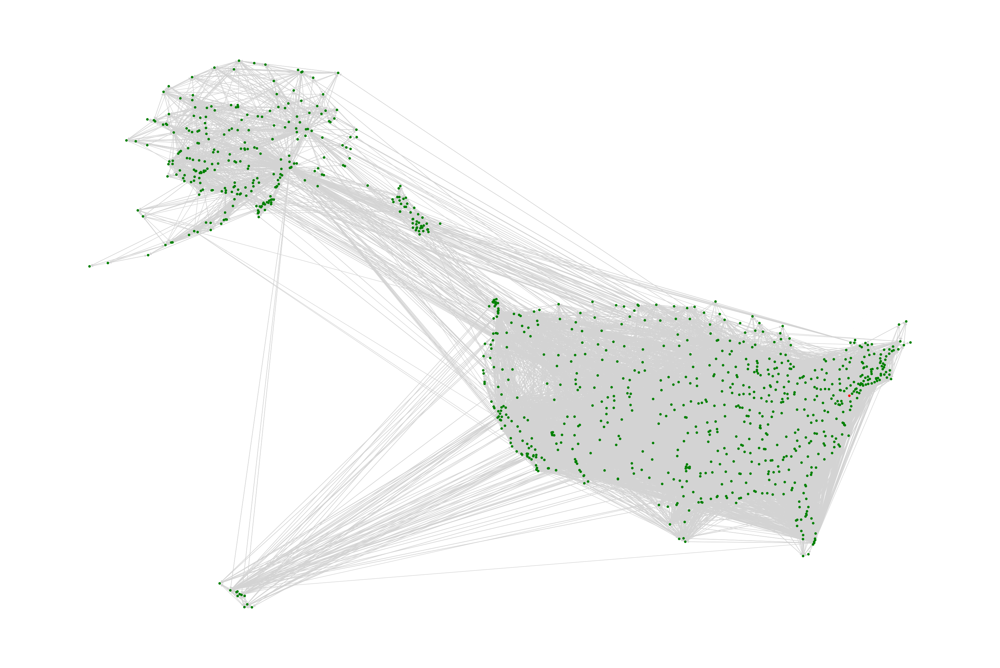

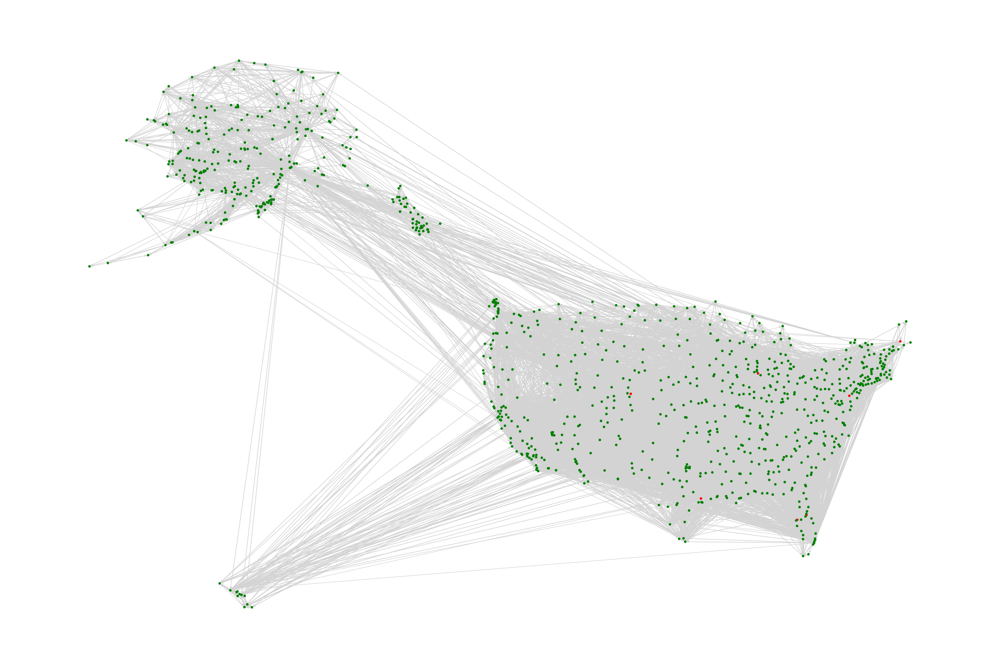

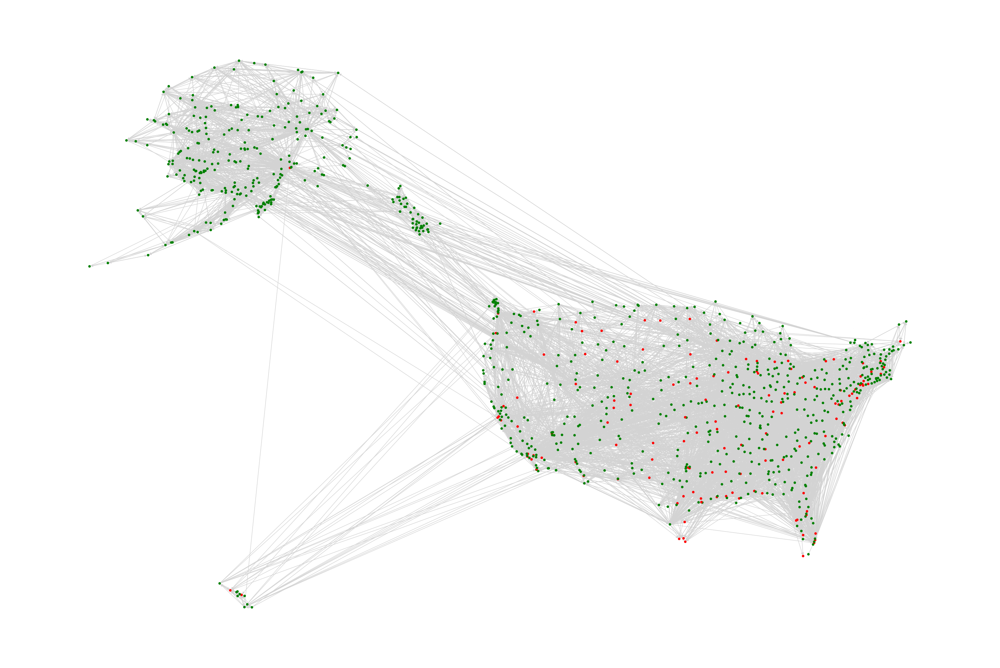

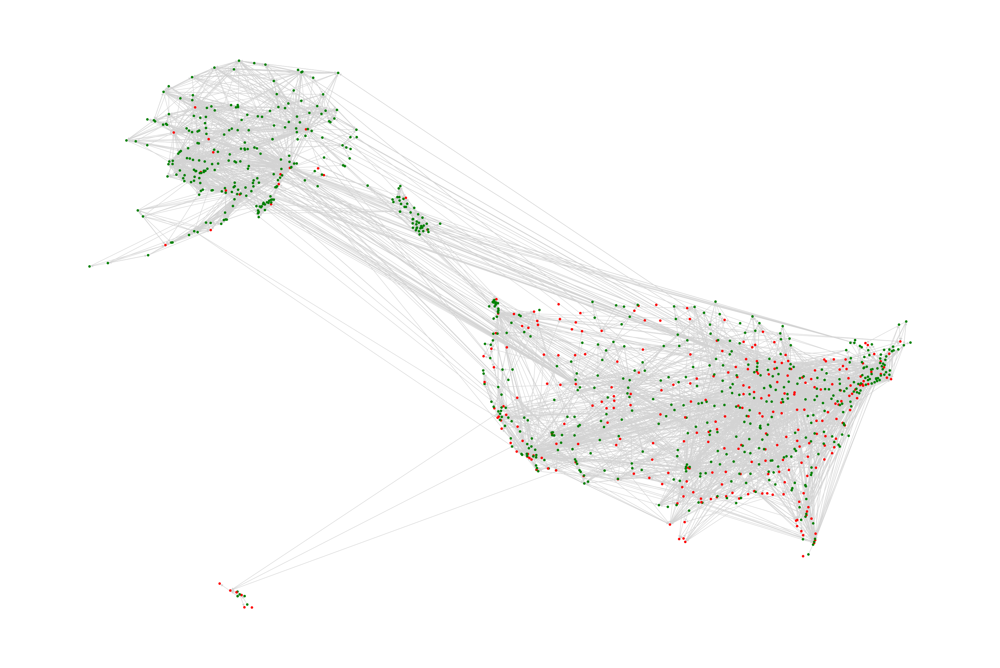

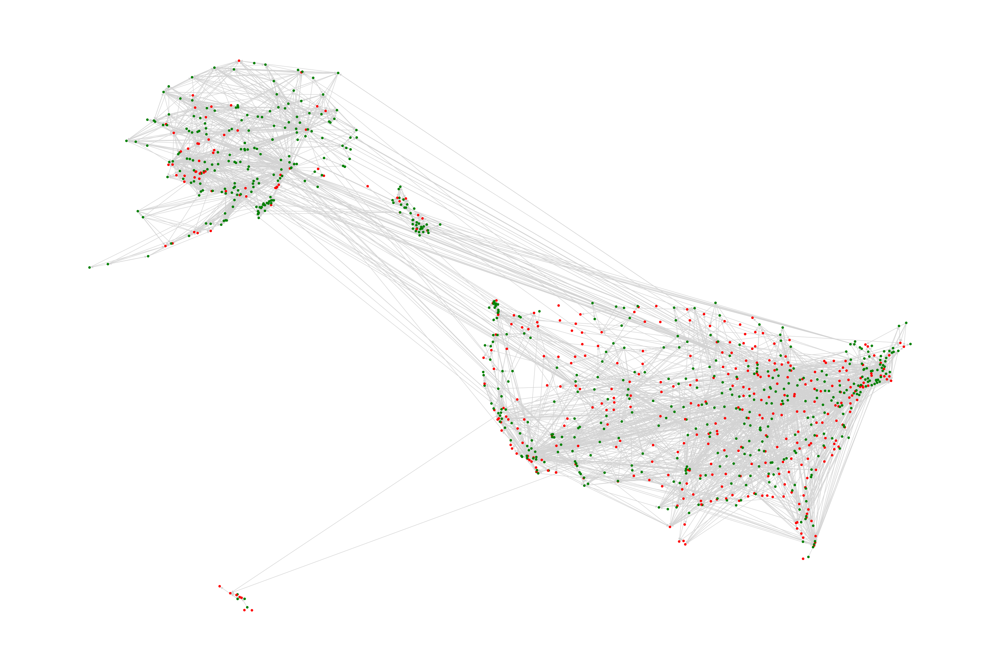

...

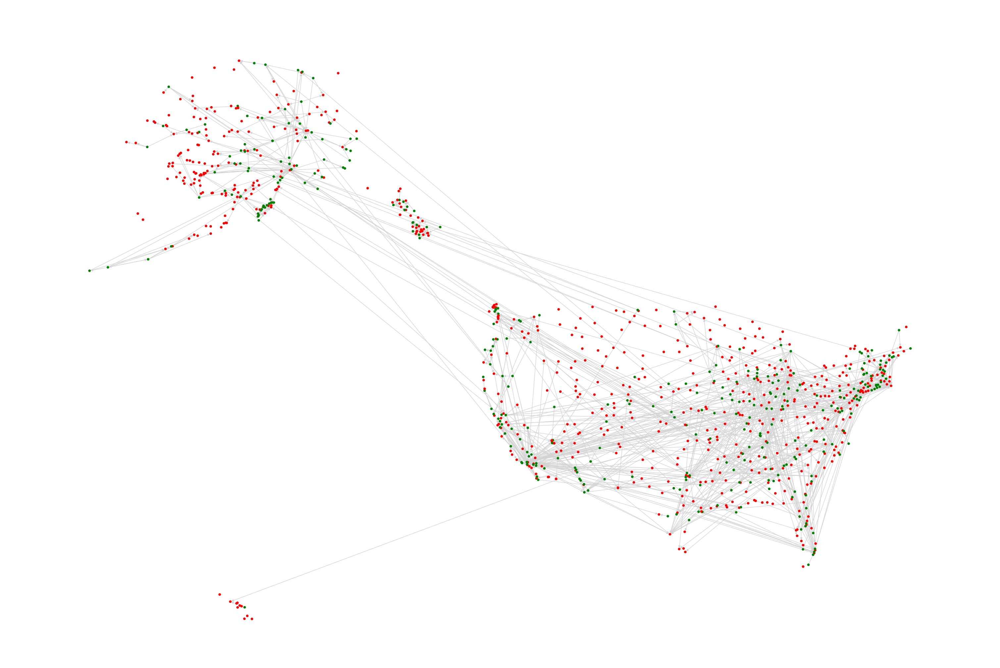

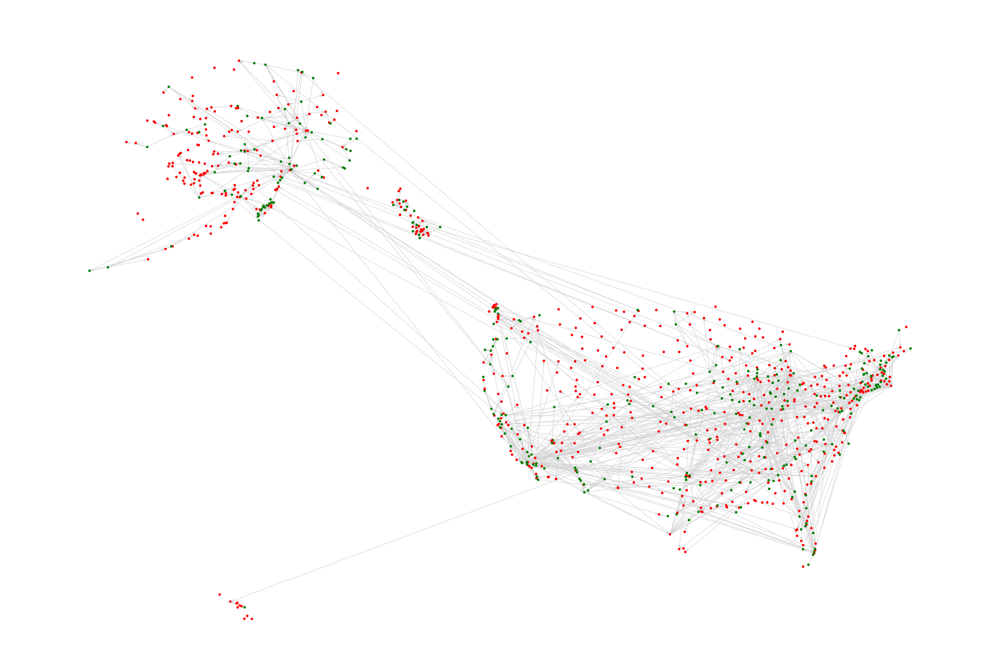

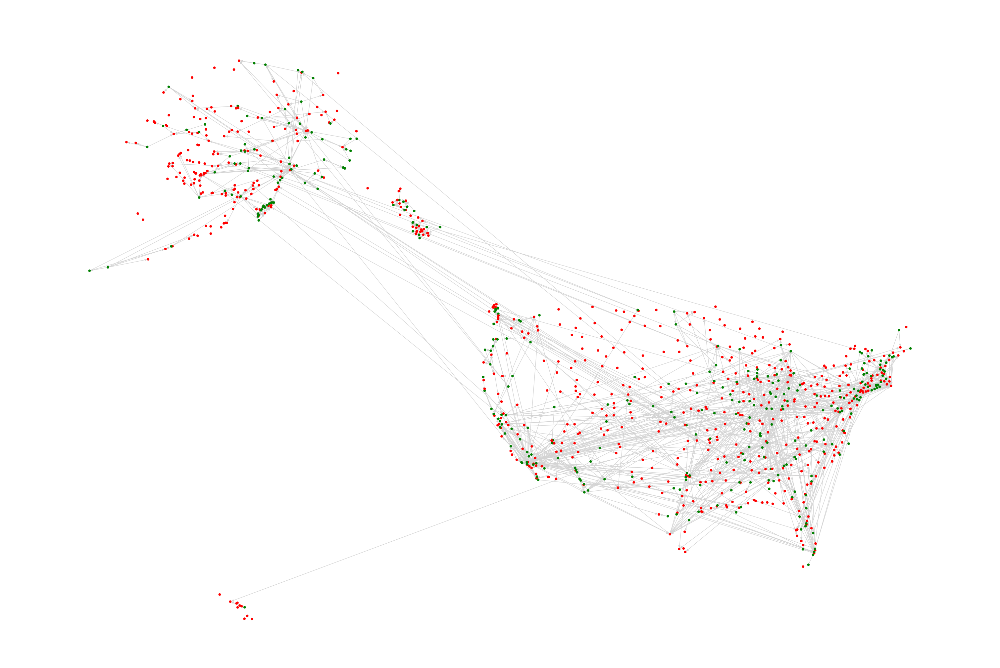

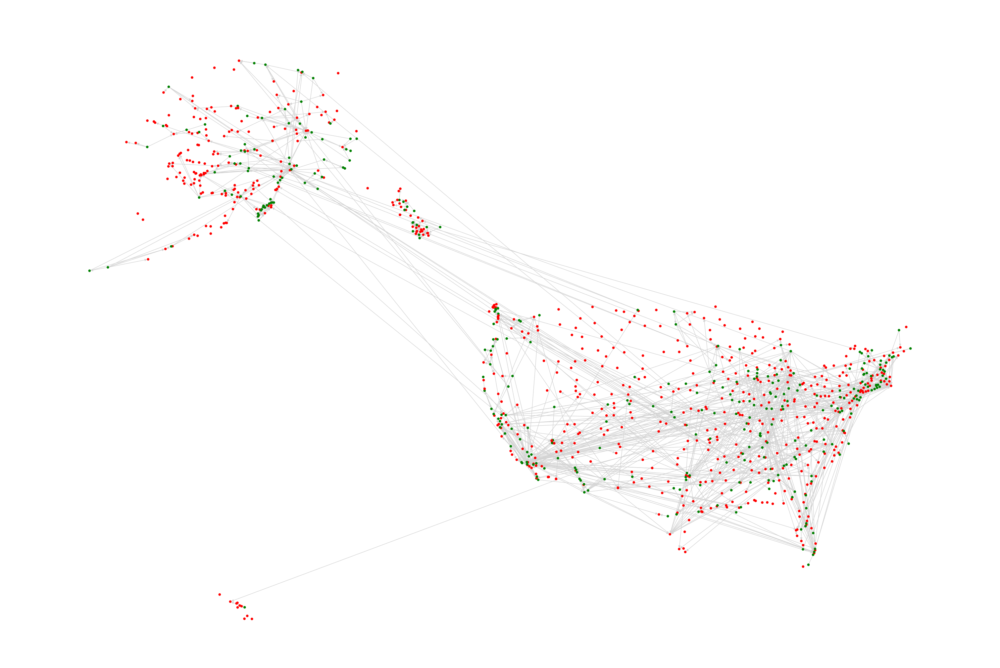

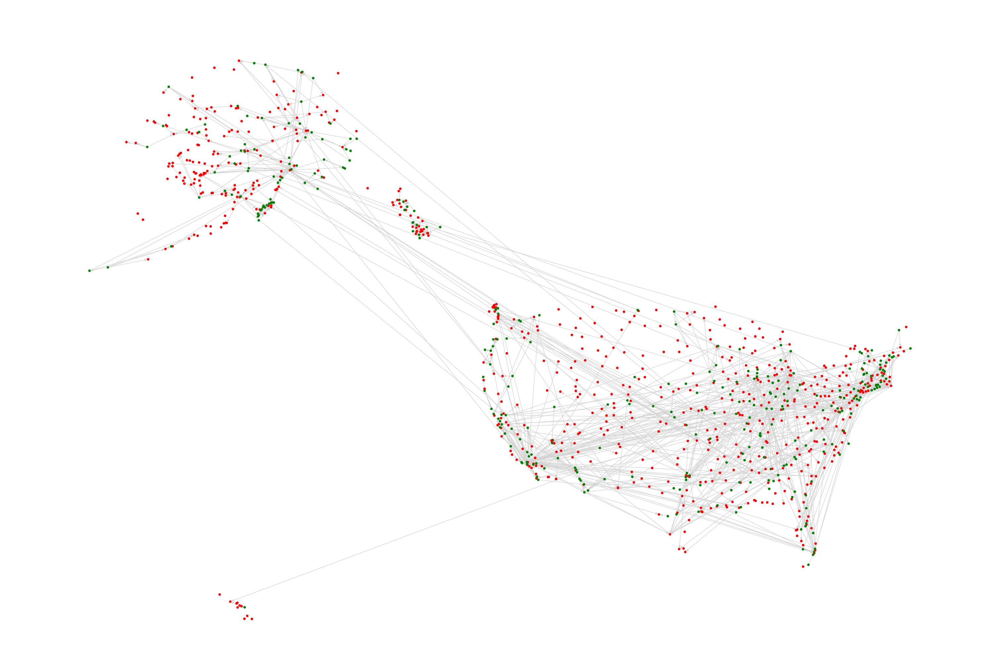

In [18]:
for index, i in enumerate(sets[0:]):
    fig = plt.figure(figsize =(30,20))
    col_list = ['red' if node in i else 'green' for node in G.nodes]
    remove_edges(G, i)
    nx.draw(G,pos = pos,with_labels = False,font_color = 'white',node_size = 20,node_color = col_list,edge_color = 'lightgray')
    plt.savefig('test'+ str(index) +'.png')